In [2]:
from pathlib import Path
import pickle

import mne
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from tqdm import tqdm

In [10]:
REPORTS = Path("../reports")

all_subjects = [str(i) for i in range(1, 9)]
all_features = ["bert", "glove", "postag", "deptags", "cm"]

sigs = {}
for sub in all_subjects:
    for feat in all_features:
        sig_file = REPORTS / f"sub-{sub}" / f"{feat}_s0_predictions" / "0_sig.npy" 
        if not sig_file.exists():
            print(f"Not found: {sub}, {feat}")
            continue
        sigs[feat+sub] = np.load(sig_file)
        
        
all_pairs = [
        ("bert", "glove"),
        ("postag", "deptags"),
        ("postag", "cm"),
        ("deptags", "cm"),
    ]

diff_sigs = {}
for sub in all_subjects:
    for feat in all_pairs:
        sig_file = REPORTS / f"sub-{sub}" / f"{feat[0]}_diff_{feat[1]}" / "0_sig.npy" 
        if not sig_file.exists():
            print(f"Not found: {sub}, {feat}")
            continue
        diff_sigs[feat[0]+'-'+feat[1]+sub] = np.load(sig_file)

r2s = {}
for sub in all_subjects:
    for feat in all_features:
        sig_file = REPORTS / f"sub-{sub}" / f"{feat}_s0_predictions" / "0_r2s.npy" 
        if not sig_file.exists():
            print(f"Not found: {sub}, {feat}")
            continue
        r2s[feat+sub] = np.load(sig_file)

Not found: 1, glove
Not found: 1, cm
Not found: 4, deptags
Not found: 5, deptags
Not found: 1, ('bert', 'glove')
Not found: 1, ('postag', 'deptags')
Not found: 1, ('postag', 'cm')
Not found: 1, ('deptags', 'cm')
Not found: 2, ('bert', 'glove')
Not found: 2, ('postag', 'deptags')
Not found: 2, ('postag', 'cm')
Not found: 2, ('deptags', 'cm')
Not found: 3, ('bert', 'glove')
Not found: 3, ('postag', 'deptags')
Not found: 3, ('postag', 'cm')
Not found: 3, ('deptags', 'cm')
Not found: 4, ('bert', 'glove')
Not found: 4, ('postag', 'deptags')
Not found: 4, ('postag', 'cm')
Not found: 4, ('deptags', 'cm')
Not found: 5, ('bert', 'glove')
Not found: 5, ('postag', 'deptags')
Not found: 5, ('postag', 'cm')
Not found: 5, ('deptags', 'cm')
Not found: 6, ('bert', 'glove')
Not found: 6, ('postag', 'deptags')
Not found: 6, ('postag', 'cm')
Not found: 6, ('deptags', 'cm')
Not found: 7, ('bert', 'glove')
Not found: 7, ('postag', 'deptags')
Not found: 7, ('postag', 'cm')
Not found: 7, ('deptags', 'cm')
No

## Only subject 2

In [11]:
sub = "2"

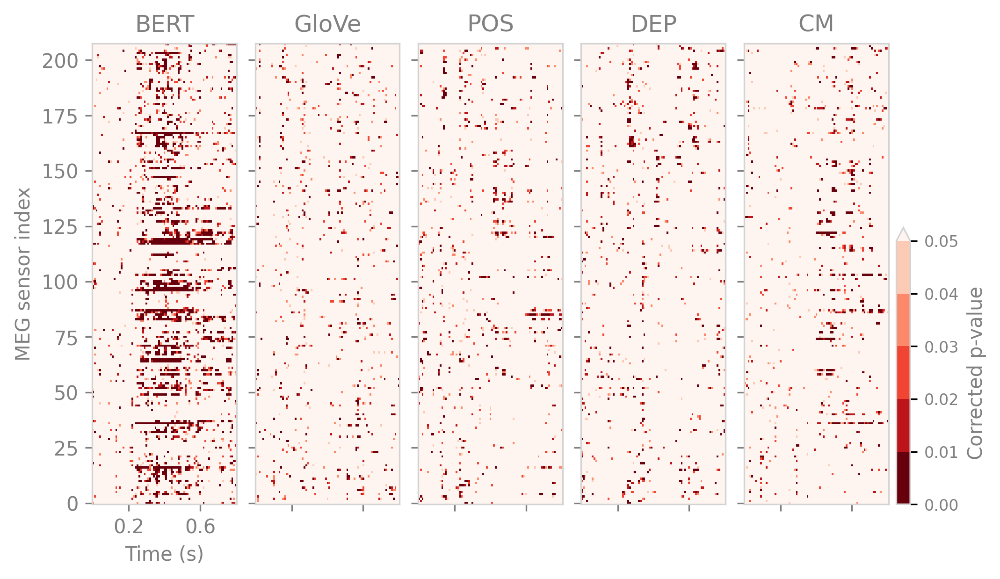

In [12]:
fig, axs = plt.subplots(1, len(all_features), figsize=(7, 4), sharey=True, constrained_layout=True)

plt.rcParams.update({'font.size': 11, 'axes.edgecolor': "lightgray"})
plt.tick_params(which="both", colors='gray')

cmap = mpl.cm.Reds
bounds = [0.0, 0.01, 0.02, 0.03, 0.04, 0.05]
norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='max')

feat_names = ["BERT", "GloVe", "POS", "DEP", "CM"]

for i, feat in enumerate(all_features):
    im = axs[i].imshow(
        sigs[feat+sub].reshape(208, 81), 
        aspect="auto", 
        cmap="Reds_r", 
        norm=norm,
        origin="lower",
        interpolation="None",
    )
    axs[i].set_title(feat_names[i], size=12, color="gray")
    axs[i].set_xticks([20, 60])
    axs[i].tick_params(axis='both', labelsize=10, color="gray")
    axs[i].tick_params(axis='y', labelsize=10, labelcolor="gray")
    
    if i==0:
        axs[i].set_xticklabels([0.2, 0.6], color="gray")
        axs[i].set_xlabel("Time (s)", size=10, color="gray")
        axs[i].set_ylabel("MEG sensor index", size=10, color="gray")
    else:
        axs[i].set_xticklabels([])
cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
cbar.ax.tick_params(labelsize=8, labelcolor="gray")
cbar.set_label(label="Corrected p-value", size=10, color="gray")

fig.savefig("../figures/uncorrected-pvalues-sub-2.pdf", bbox_inches="tight")
plt.show()

In [61]:
thr = 0.001  # uncorrected p-value threshold

sig_sub_count = {}
for feat in all_features:
    count = np.zeros((208, 81))
    for subfeat, sig in sigs.items():
        if feat in subfeat:
            s = sig.reshape(208, 81)
            h0_rejected = s.copy()
            h0_rejected[s < thr] = 1.0
            h0_rejected[s >= thr] = 0.0
            count += h0_rejected
        sig_sub_count[feat] = count

## Signigicance by number of subjects

In [64]:
thr = 0.001  # uncorrected p-value threshold

sig_sub_count = {}
for feat in all_features:
    count = np.zeros((208, 81))
    for subfeat, sig in sigs.items():
        if feat in subfeat:
            s = sig.reshape(208, 81)
            h0_rejected = s.copy()
            h0_rejected[s < thr] = 1.0
            h0_rejected[s >= thr] = 0.0
            count += h0_rejected
        sig_sub_count[feat] = count

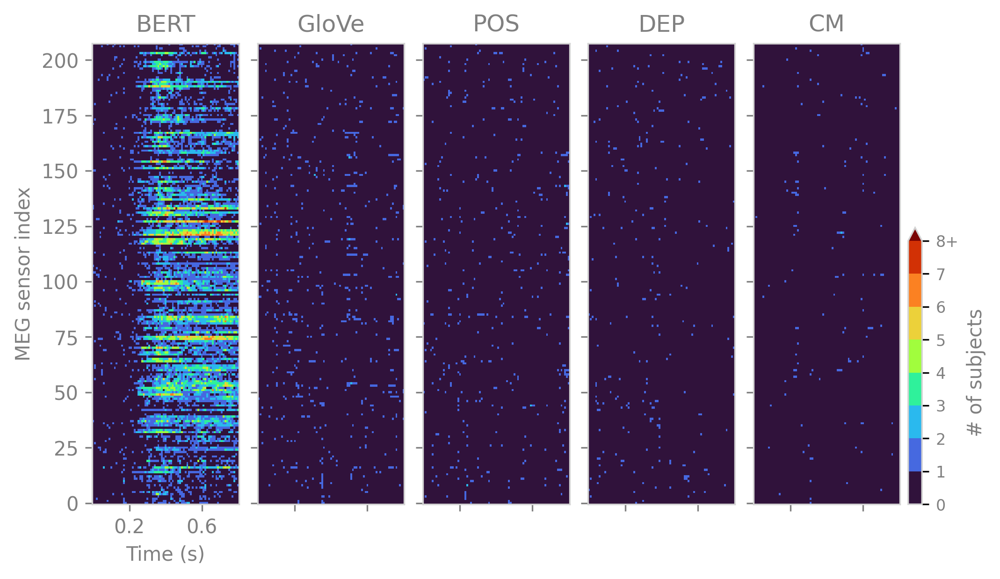

In [65]:
fig, axs = plt.subplots(1, len(all_features), figsize=(7, 4), sharey=True, constrained_layout=True)

plt.rcParams.update({'font.size': 11, 'axes.edgecolor': "lightgray"})
plt.tick_params(which="both", colors='gray')

cmap = mpl.cm.turbo
bounds = list(range(9))
norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend="max")

feat_names = ["BERT", "GloVe", "POS", "DEP", "CM"]

for i, feat in enumerate(all_features):
    im = axs[i].imshow(
        sig_sub_count[feat], 
        aspect="auto", 
        cmap="turbo", 
        norm=norm,
        origin="lower",
        interpolation="None",
    )
    axs[i].set_title(feat_names[i], size=12, color="gray")
    axs[i].set_xticks([20, 60])
    axs[i].tick_params(axis='both', labelsize=10, color="gray")
    axs[i].tick_params(axis='y', labelsize=10, labelcolor="gray")
    
    if i==0:
        axs[i].set_xticklabels([0.2, 0.6], color="gray")
        axs[i].set_xlabel("Time (s)", size=10, color="gray")
        axs[i].set_ylabel("MEG sensor index", size=10, color="gray")
    else:
        axs[i].set_xticklabels([])
cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
cbar.ax.tick_params(labelsize=8, labelcolor="gray")
cbar.ax.set_yticklabels(bounds[:-1] + [str(bounds[-1]) + "+"])
cbar.set_label(label="# of subjects", size=10, color="gray")

fig.savefig("../figures/uncorrected-pvalues-sub-count.pdf", bbox_inches="tight")
plt.show()

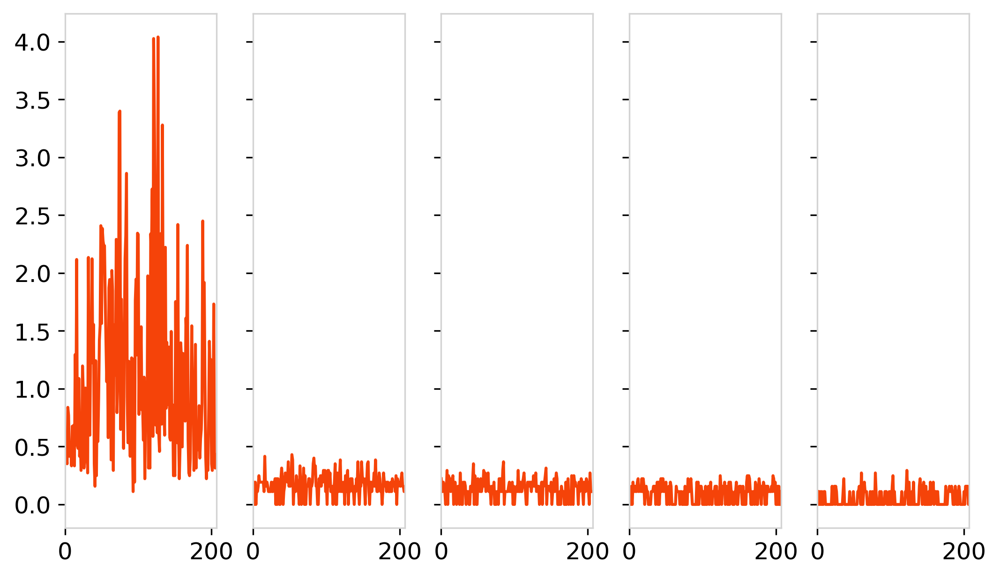

In [73]:
def rms(x):
    return np.sqrt(np.mean(x**2, axis=1))

fig, axs = plt.subplots(1, len(all_features), figsize=(7, 4), sharey=True, constrained_layout=True)

for i, feat in enumerate(all_features):
    axs[i].plot(rms(sig_sub_count[feat]))
plt.show()

### As topomap

In [66]:
with open("../data/formatted/word/info-12-word-100Hz-800ms-no-baseline.pkl", "rb") as fp:
    info = pickle.load(fp)

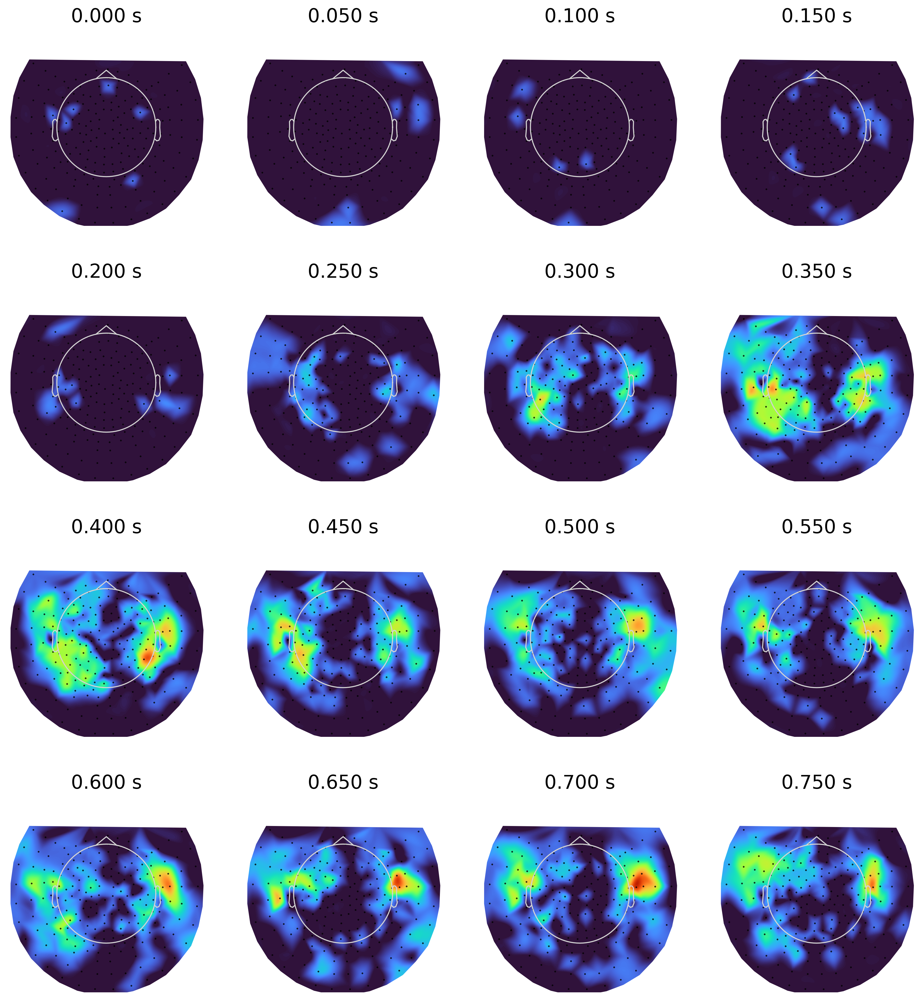

In [67]:
feat = "bert"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

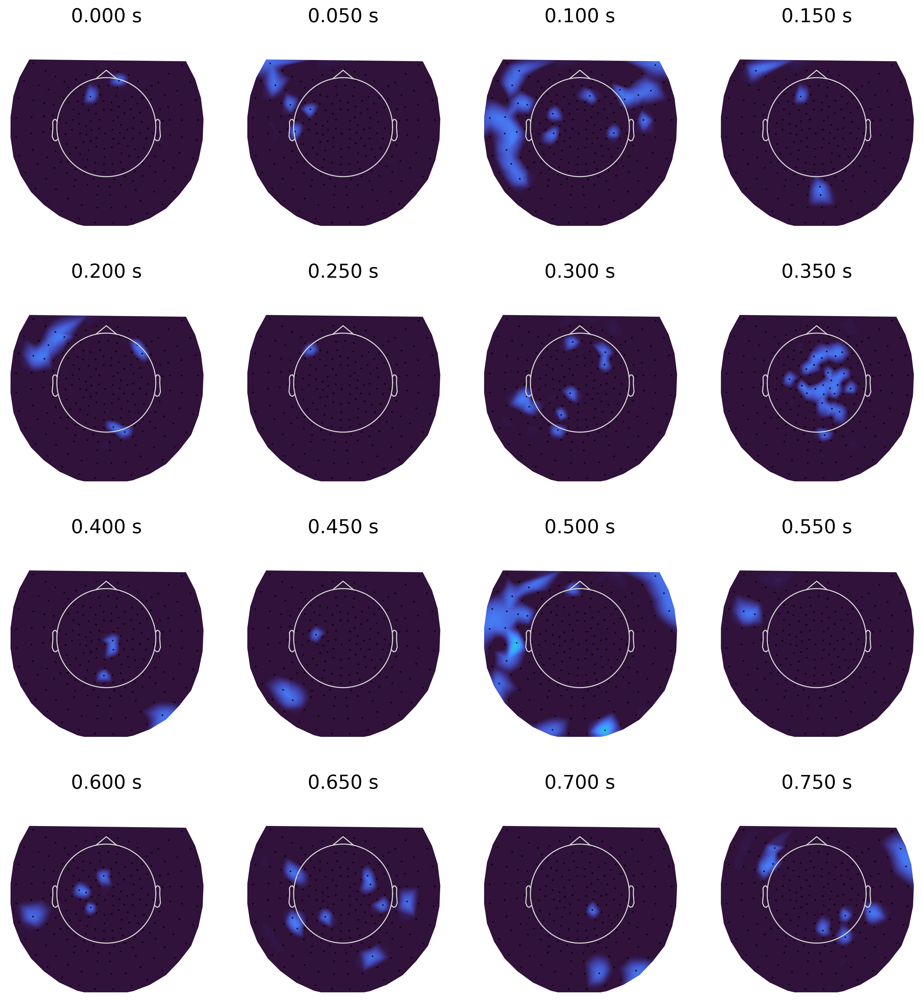

In [68]:
feat = "glove"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

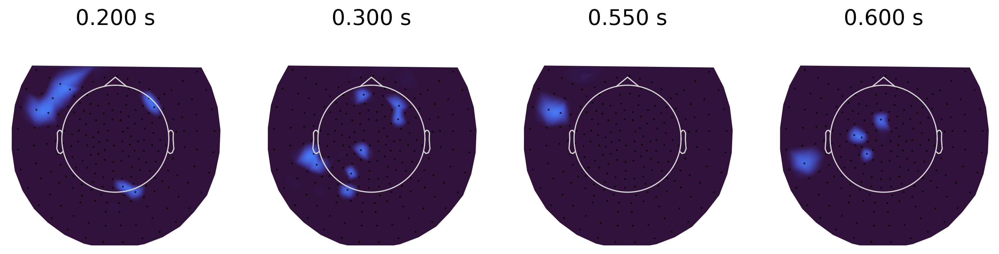

In [69]:
feat = "glove"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = [0.2, 0.3, 0.55, 0.6]
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-detail-{feat}-topo.pdf")
plt.show()

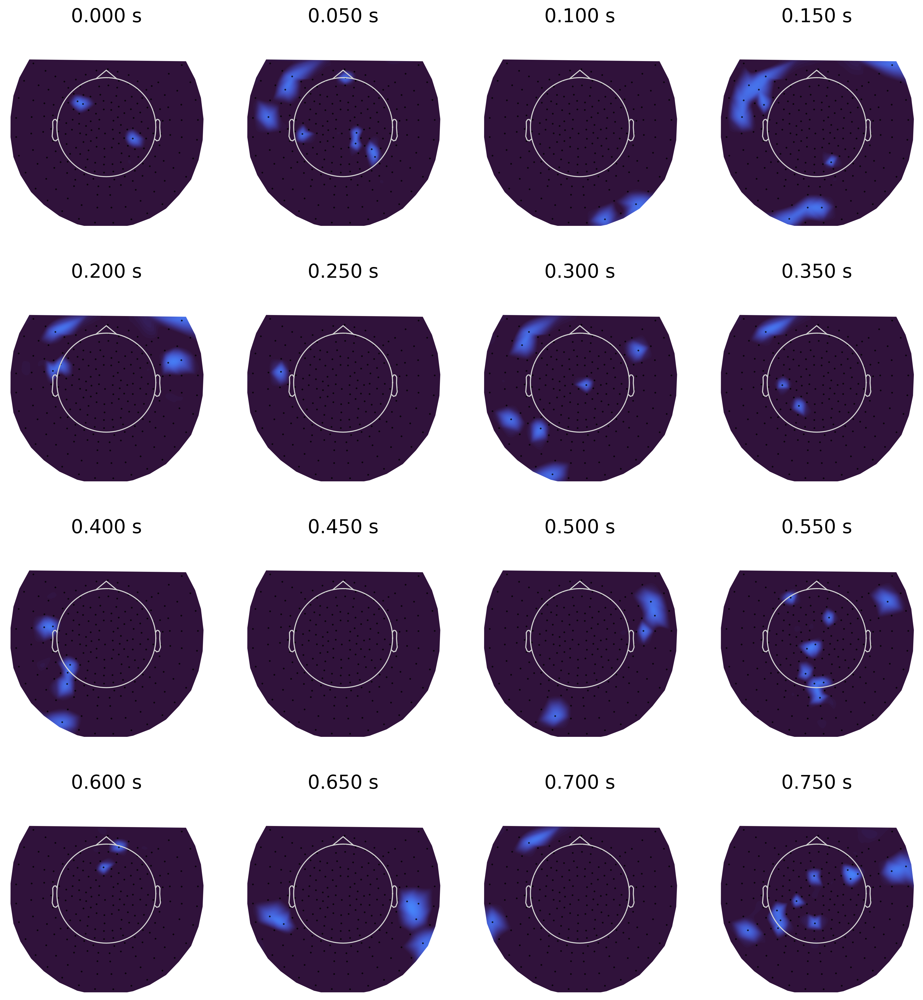

In [70]:
feat = "postag"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

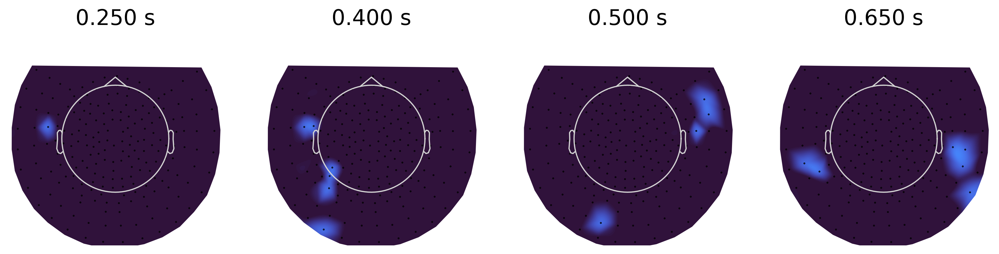

In [71]:
feat = "postag"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = [0.25, 0.4, 0.5, 0.65]
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-detail-{feat}-topo.pdf")
plt.show()

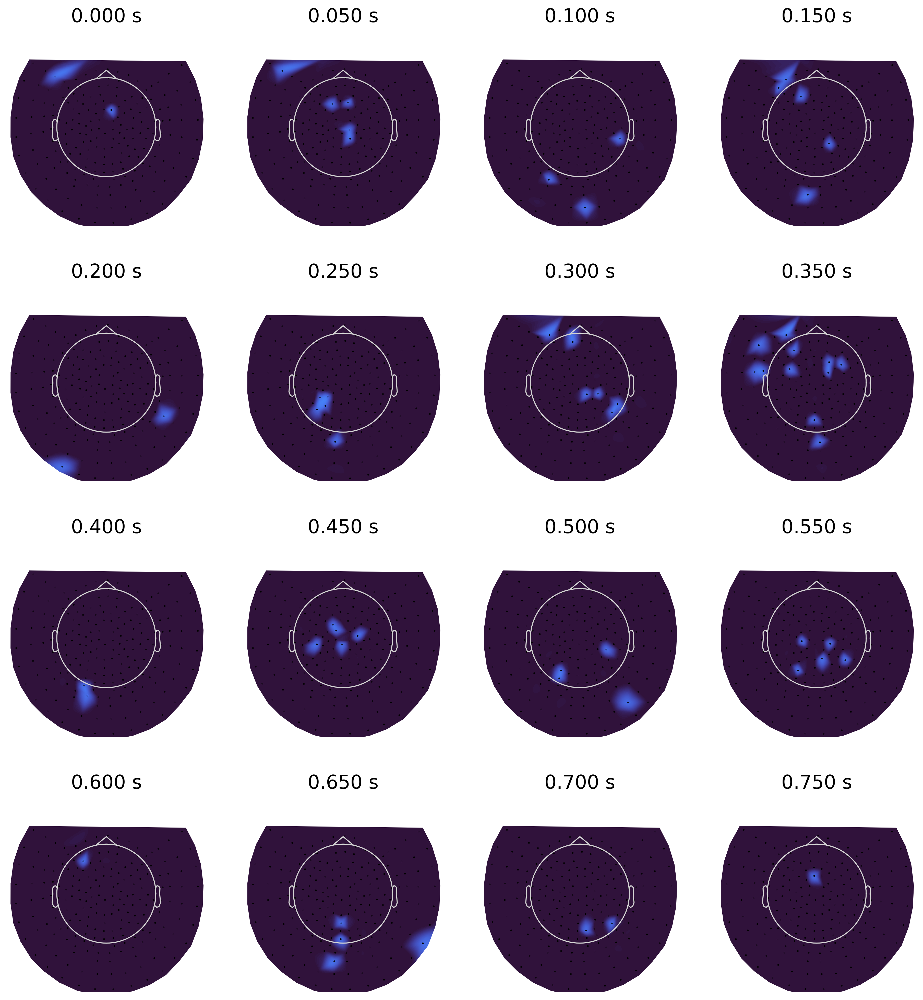

In [72]:
feat = "deptags"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

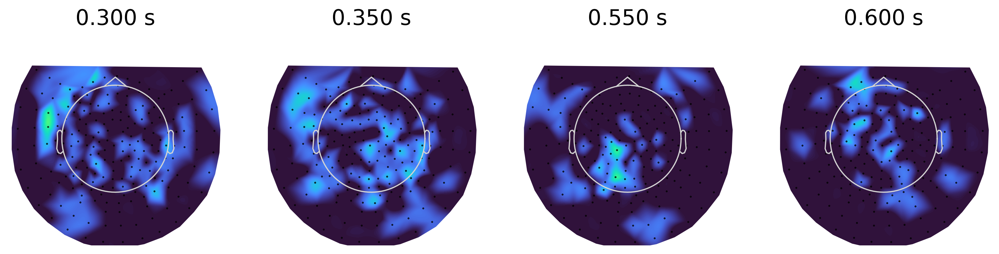

In [57]:
feat = "deptags"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = [0.3, 0.35, 0.55, 0.6]
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-detail-{feat}-topo.pdf")
plt.show()

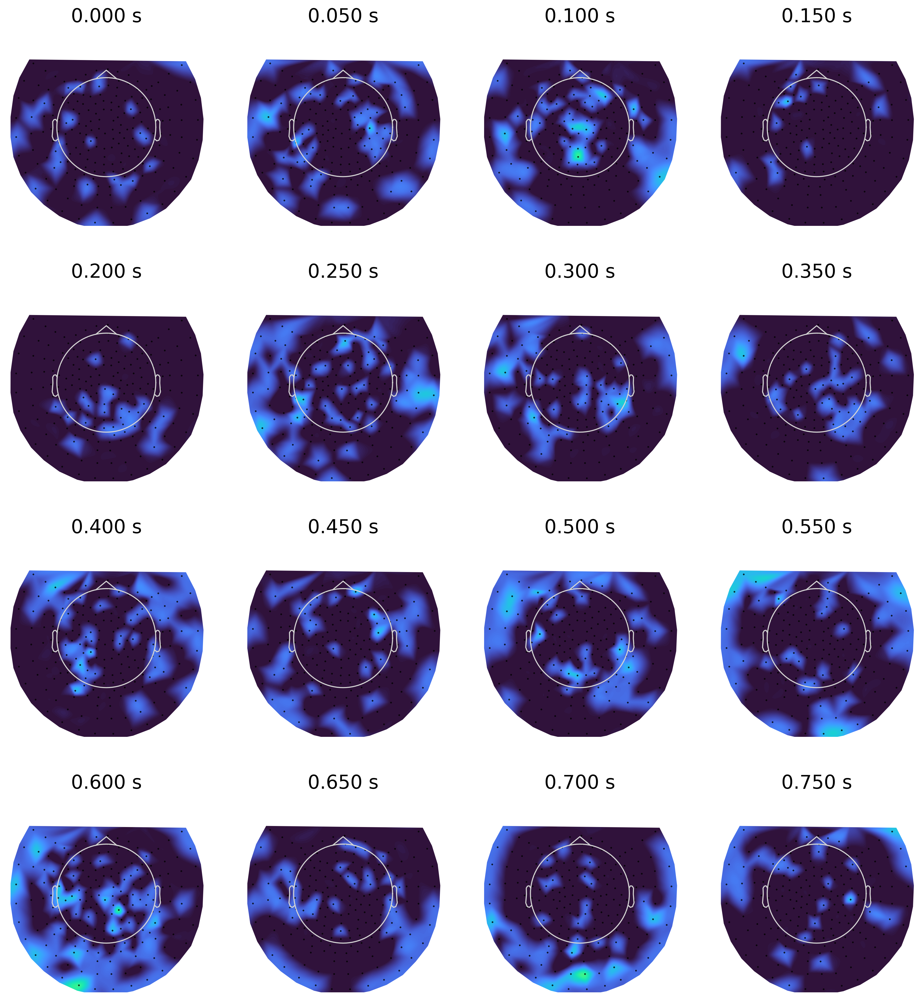

In [59]:
feat = "cm"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

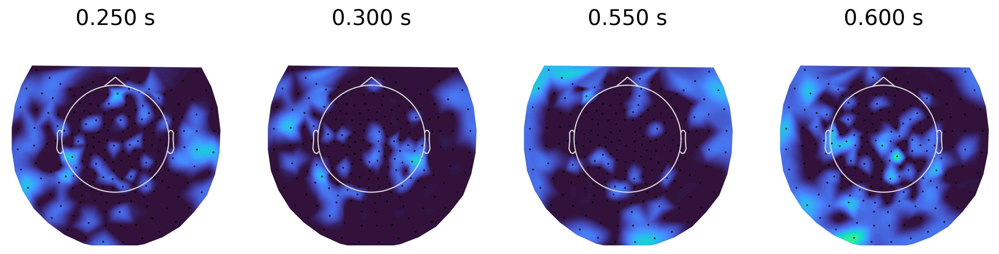

In [60]:
feat = "cm"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = [0.25, 0.3, 0.55, 0.6]
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/uncorrected-pvalues-sub-count-detail-{feat}-topo.pdf")
plt.show()

## Diff topomaps

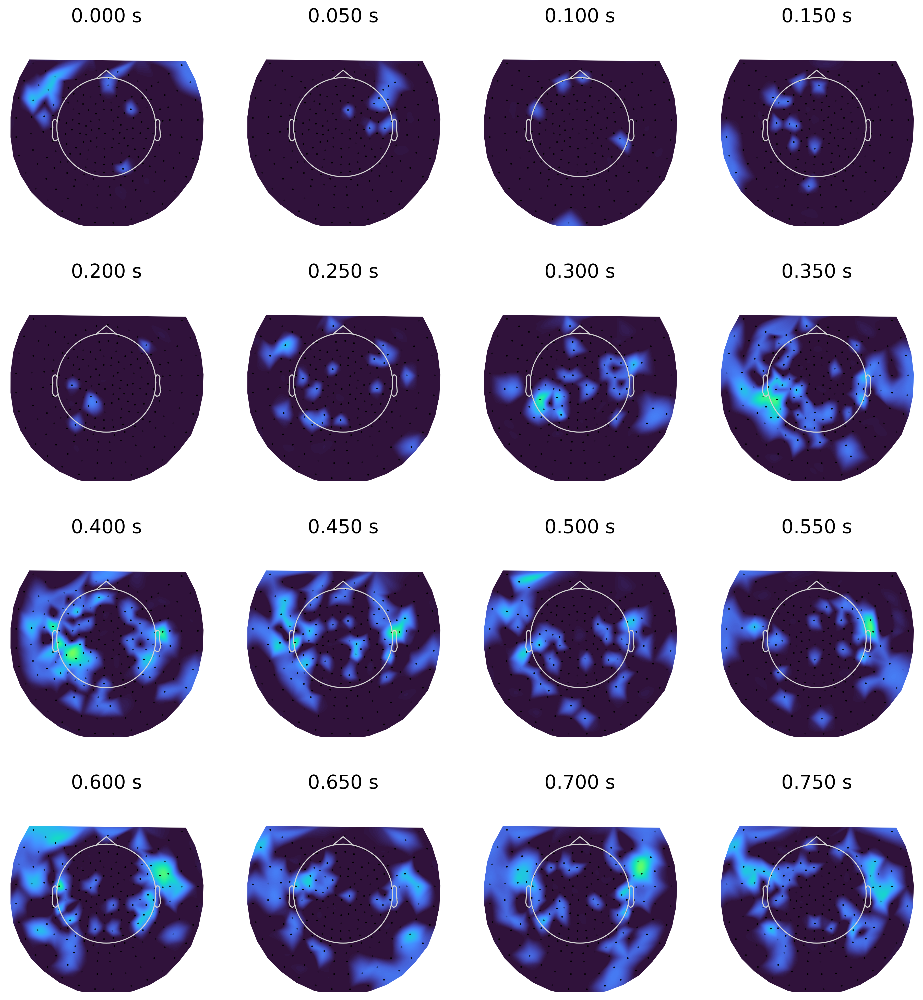

In [89]:
feat = "bert-glove"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(diff_sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/diff-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

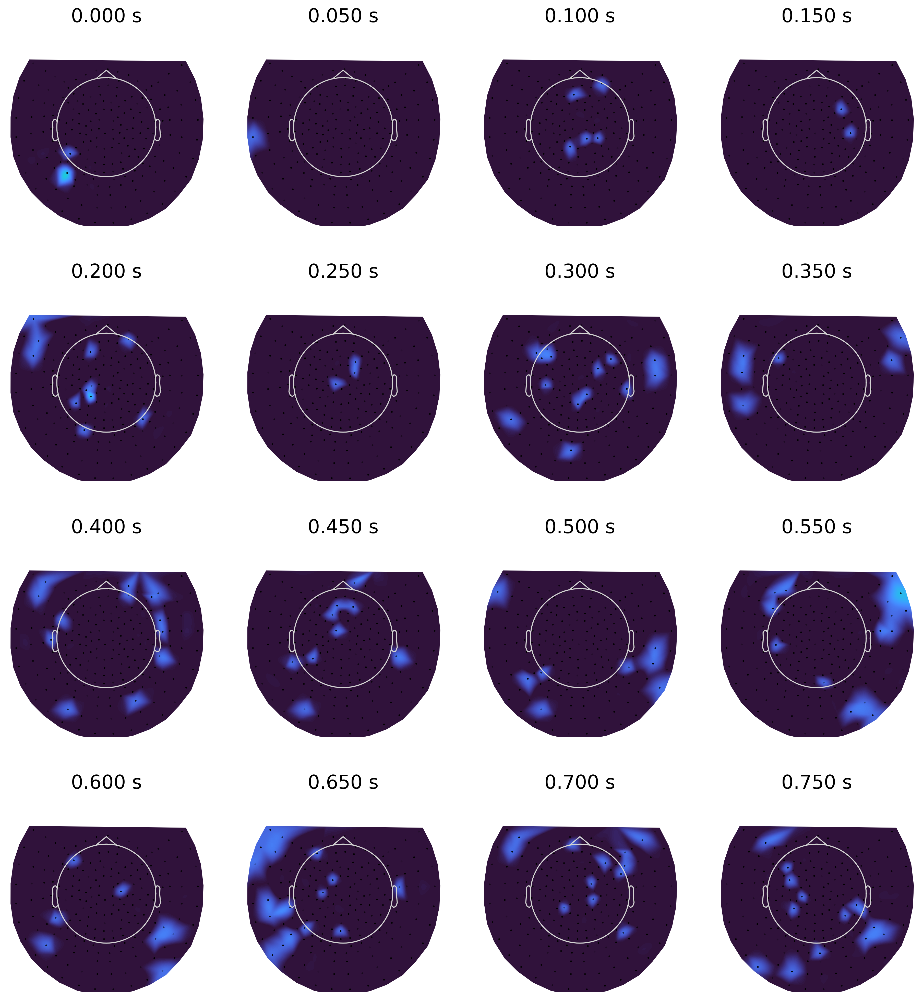

In [90]:
feat = "postag-deptags"
sub_upper_bound = 8
evo = mne.EvokedArray(np.clip(diff_sig_sub_count[feat], None, sub_upper_bound) -sub_upper_bound/2, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/diff-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

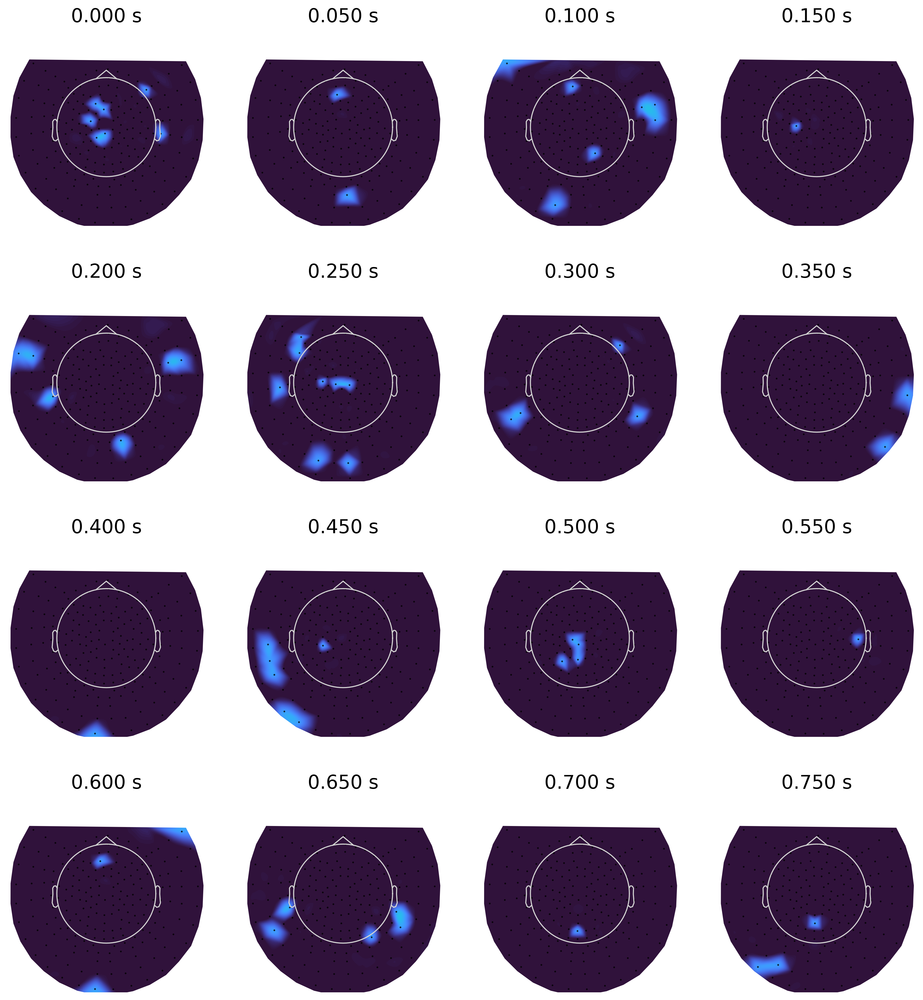

In [48]:
feat = "postag-cm"
evo = mne.EvokedArray(np.clip(diff_sig_sub_count[feat], None, 5) - 2.5, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/diff-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

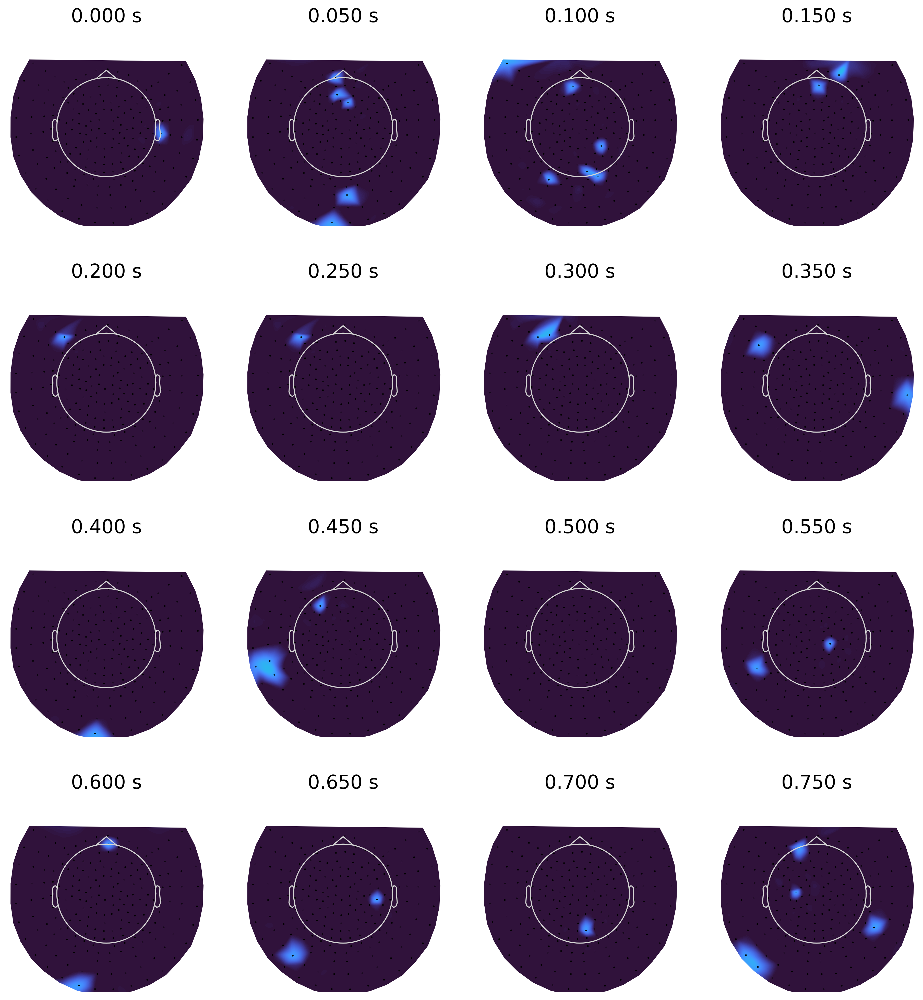

In [49]:
feat = "deptags-cm"
evo = mne.EvokedArray(np.clip(diff_sig_sub_count[feat], None, 5) - 2.5, info)
times = np.arange(0.0, 0.8, 0.05)
# cmap = mpl.cm.turbo
# bounds = [0, 1, 2, 3, 4, 5, 6, 7, 8]
# norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig = evo.plot_topomap(
    times, 
    cmap="turbo",
    ncols=4, 
    nrows=4, 
    #vlim=(0.0, 1000),
    contours=0, 
    image_interp="cubic",
    #cnorm=norm,
    colorbar=False,
    res=128,
    size=2,
)

# axes = fig.axes
# im = axes[0].get_images()[0]

# cbar = fig.colorbar(im, ax=axs, orientation="vertical", shrink=0.6, pad=0.01, anchor=(0.0, 0.0))
# cbar.ax.tick_params(labelsize=8, labelcolor="gray")
# cbar.set_label(label="Number of subjects", size=10, color="gray")

fig.savefig(f"../figures/diff-pvalues-sub-count-{feat}-topo.pdf")
plt.show()

# OLD SCRIPTS BELOW

In [2]:
sub = "2"
feat = "bert"
sig = np.load(f"../reports/sub-{sub}/{feat}_s0_predictions/0_sig_group_corrected.npy")

In [3]:
sig.shape

(16848,)

In [13]:
REPORTS = Path("../reports")

from statsmodels.stats.multitest import fdrcorrection

all_subjects = [str(i) for i in range(1, 9)]
all_features = ["bert", "glove", "postag", "deptags", "cm"]

missing_sig = []

all_uncorrected_sig = []
for sub in all_subjects:
    for feat in tqdm(all_features, f"Subject: {sub}"):
        sig_file = REPORTS / f"sub-{sub}" / f"{feat}_s0_predictions" / "0_sig.npy" 
        if not sig_file.exists():
            missing_sig.append((sub, feat))
            continue
        uncorrected_sig = np.load(sig_file)
        all_uncorrected_sig.append(uncorrected_sig)
        
q = 0.2
rejected, corrected = fdrcorrection(np.hstack(all_uncorrected_sig), q)

Subject: 8: 100%|███████████████████████████████| 5/5 [00:00<00:00, 2141.70it/s]


In [14]:
last_end = 0
ind = 0
corr_sig = {}
h0_rejected = {}
for sub in all_subjects:
    for feat in all_features:
        if (sub, feat) in missing_sig:
            continue
        corr_sig[feat+sub] = corrected[last_end:last_end + all_uncorrected_sig[ind].shape[0]]
        h0_rejected[feat+sub] = rejected[last_end:last_end + all_uncorrected_sig[ind].shape[0]]

        last_end += all_uncorrected_sig[ind].shape[0]
        ind += 1

In [15]:
corrected.shape, rejected.shape

((606528,), (606528,))

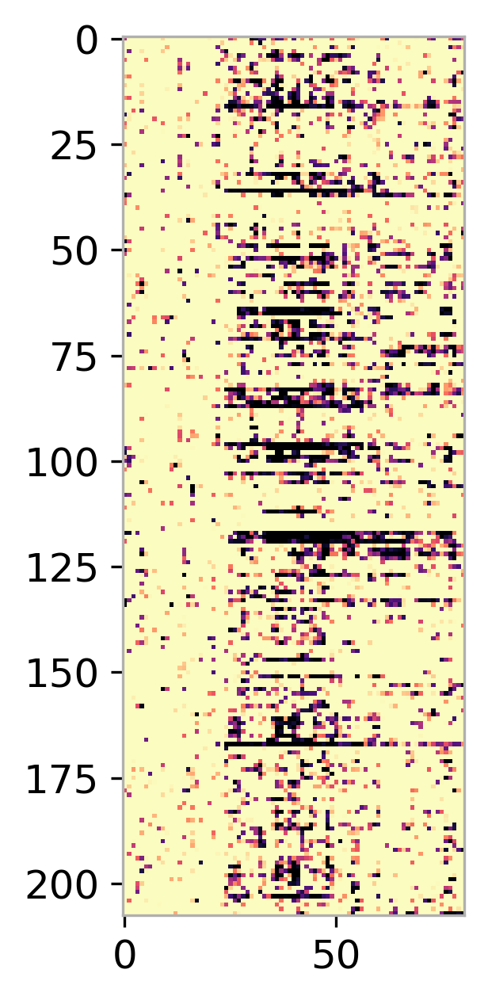

In [16]:
plt.imshow(corr_sig["bert2"].reshape(208, 81))
plt.show()

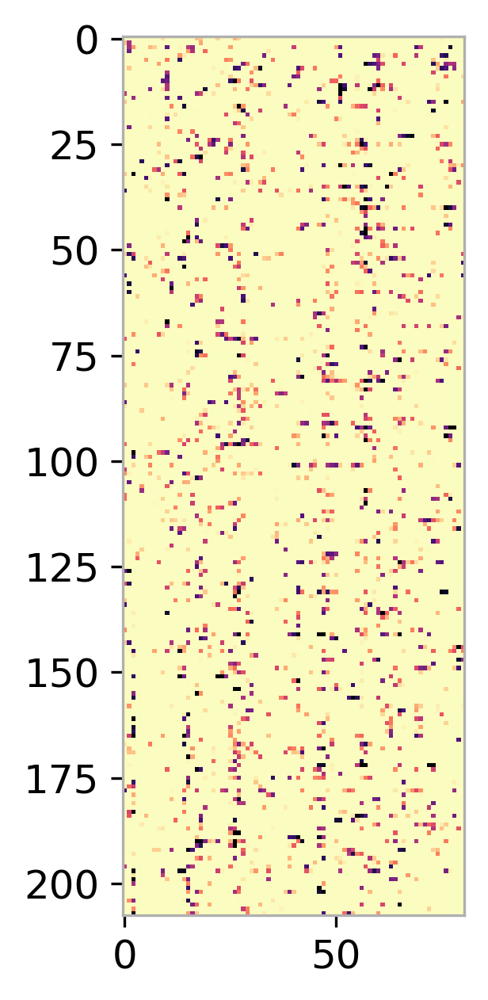

In [17]:
plt.imshow(corr_sig["glove2"].reshape(208, 81))

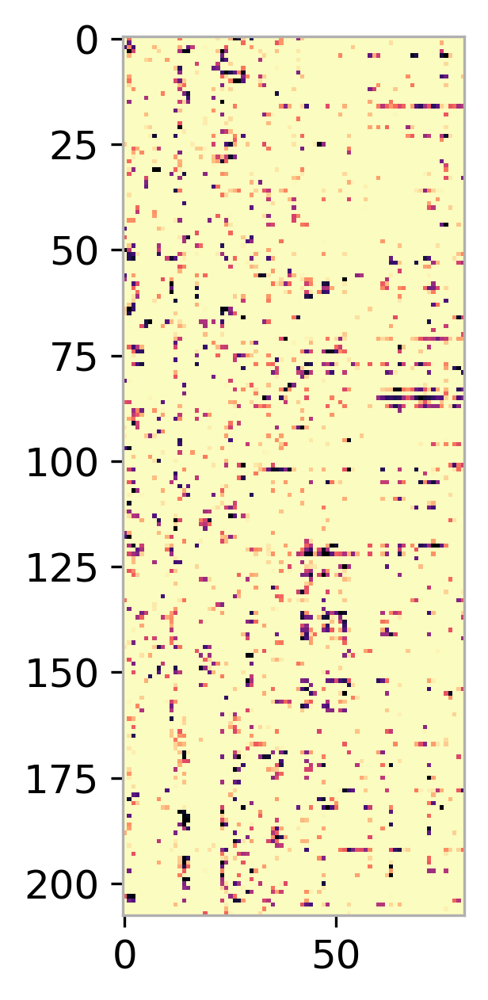

In [18]:
plt.imshow(corr_sig["postag2"].reshape(208, 81))

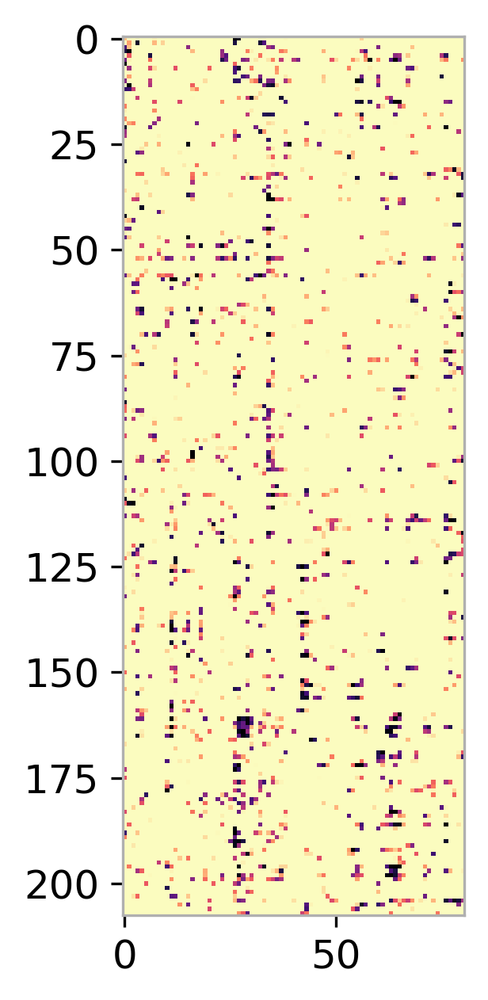

In [19]:
plt.imshow(corr_sig["deptags2"].reshape(208, 81))

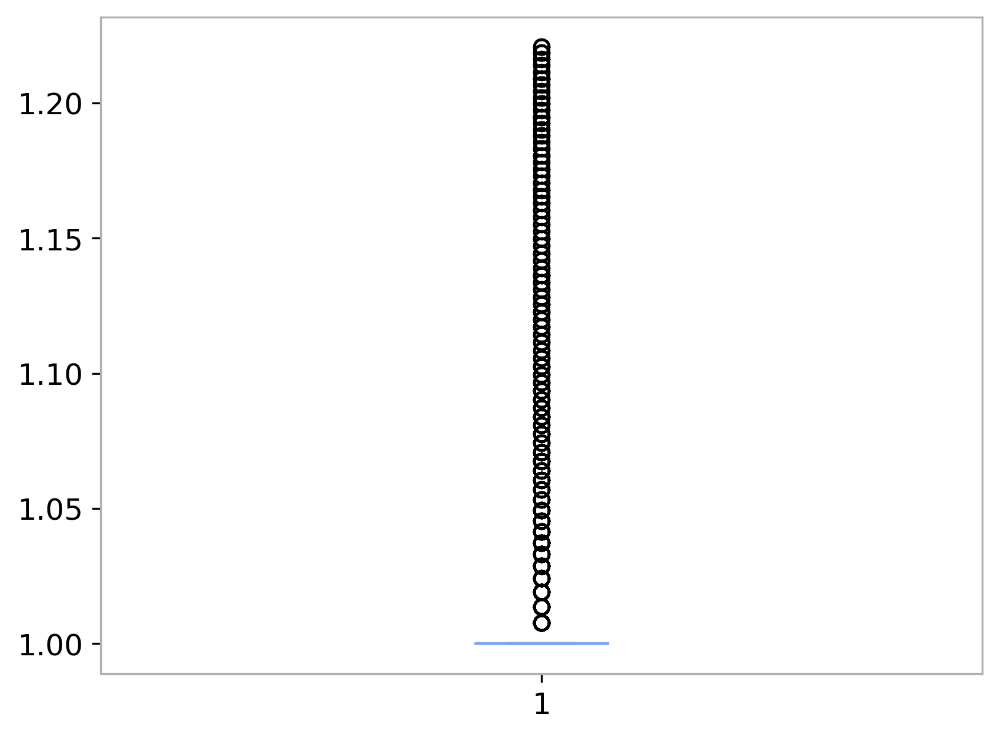

In [90]:
plt.boxplot(np.exp(corr))
plt.show()

In [44]:
with open("../data/formatted/word/info-12-word-100Hz-800ms-no-baseline.pkl", "rb") as fp:
        info = pickle.load(fp)

In [109]:
r2 = np.load( REPORTS / f"sub-2" / f"bert_s0_predictions" / "0_r2s.npy" )

In [114]:
r2s = r2.copy()
r2s[~h0_rejected["bert2"]] = 0.0

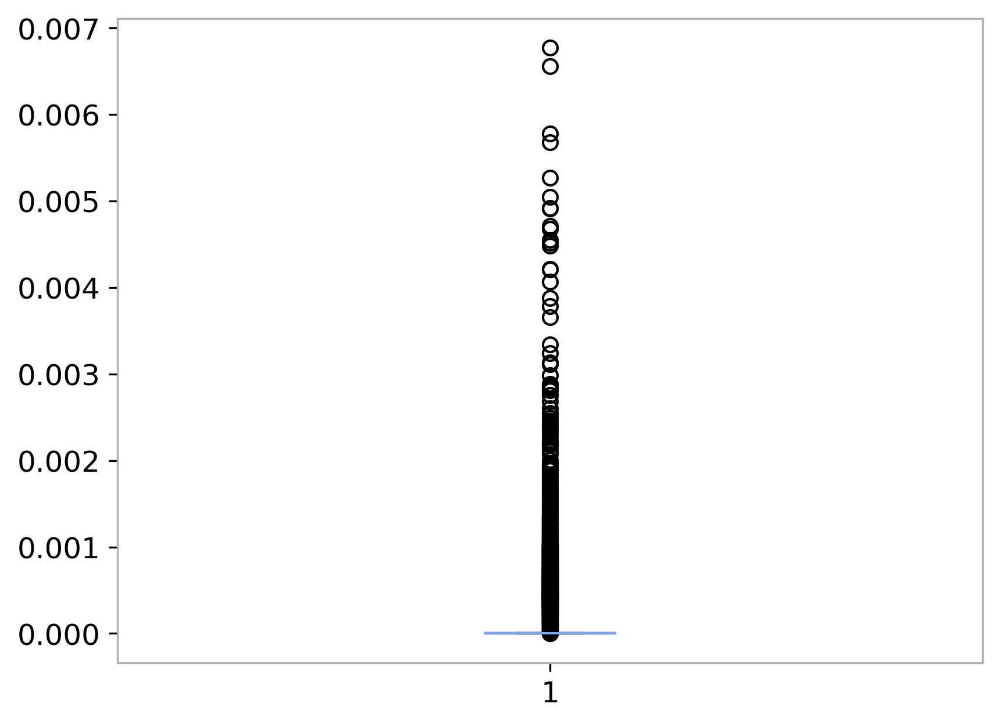

In [118]:
plt.boxplot(np.clip(r2s, 0, None))
plt.show()

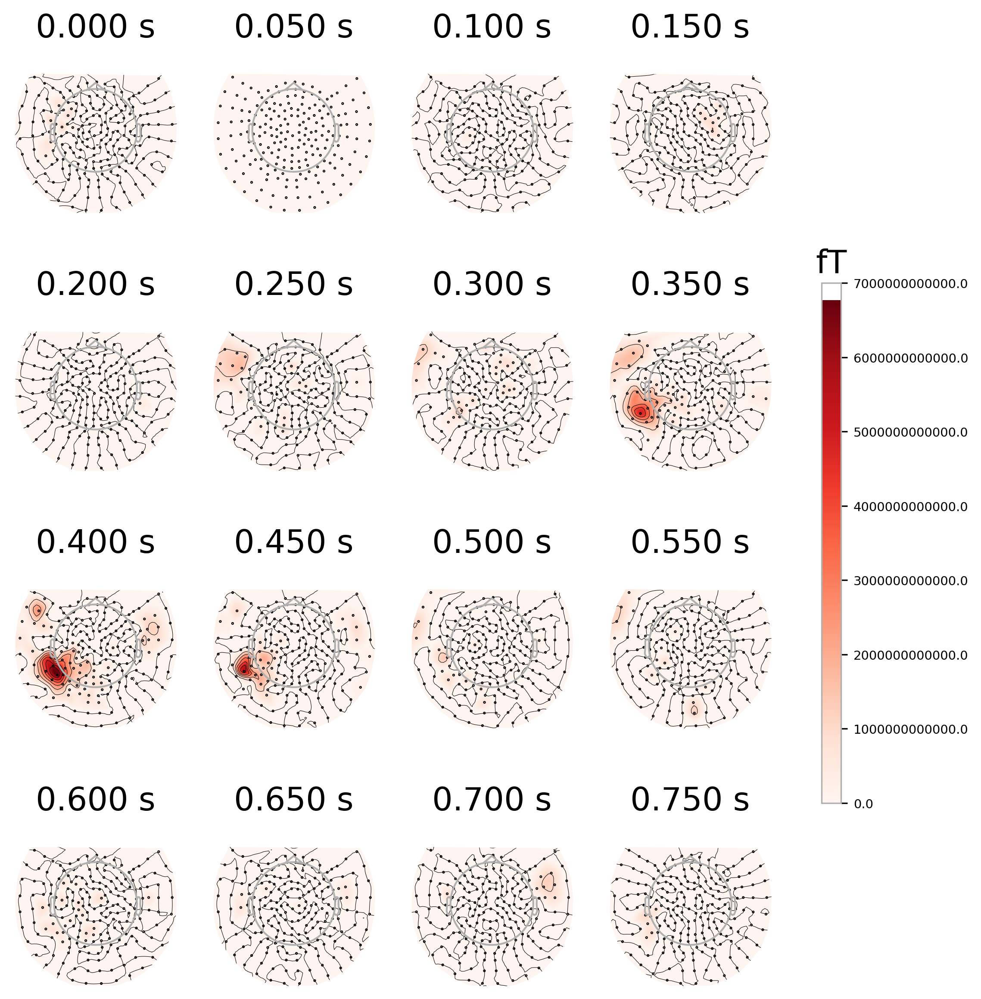

In [126]:
evo = mne.EvokedArray(np.clip(r2s, 0, None).reshape(208, 81), info)
times = np.arange(0.0, 0.8, 0.05)
evo.plot_topomap(times, cmap="Reds", ncols=4, nrows=4, vlim=(0.0, None))
plt.show()

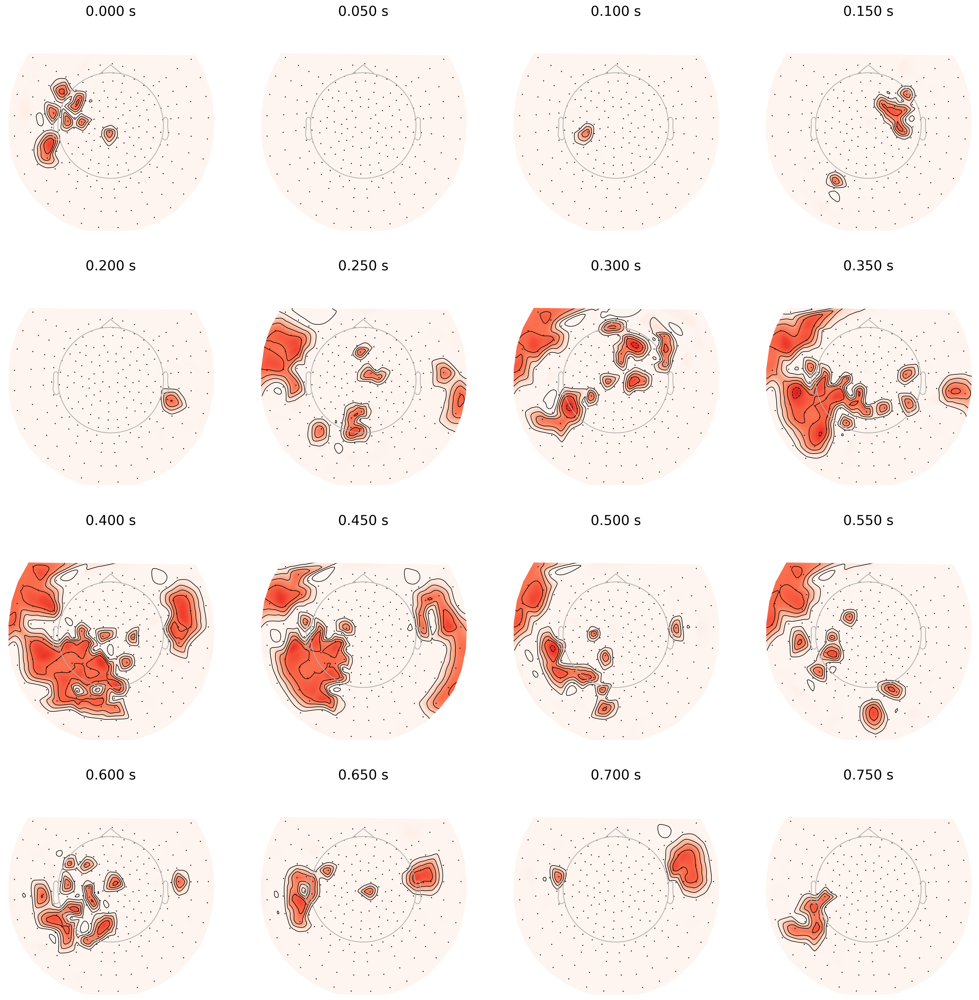

<Figure size 1920x1440 with 0 Axes>

In [132]:
corr = corr_sig["bert2"].copy()
corr[~h0_rejected["bert2"]] = 1.0
evo = mne.EvokedArray(corr.reshape(208, 81), info)
times = np.arange(0.0, 0.8, 0.05)
evo.plot_topomap(times, cmap="Reds_r", ncols=4, nrows=4, colorbar=False, res=128, size=3)
plt.savefig("../figures/sig-corrected-bert-2.pdf")
plt.show()

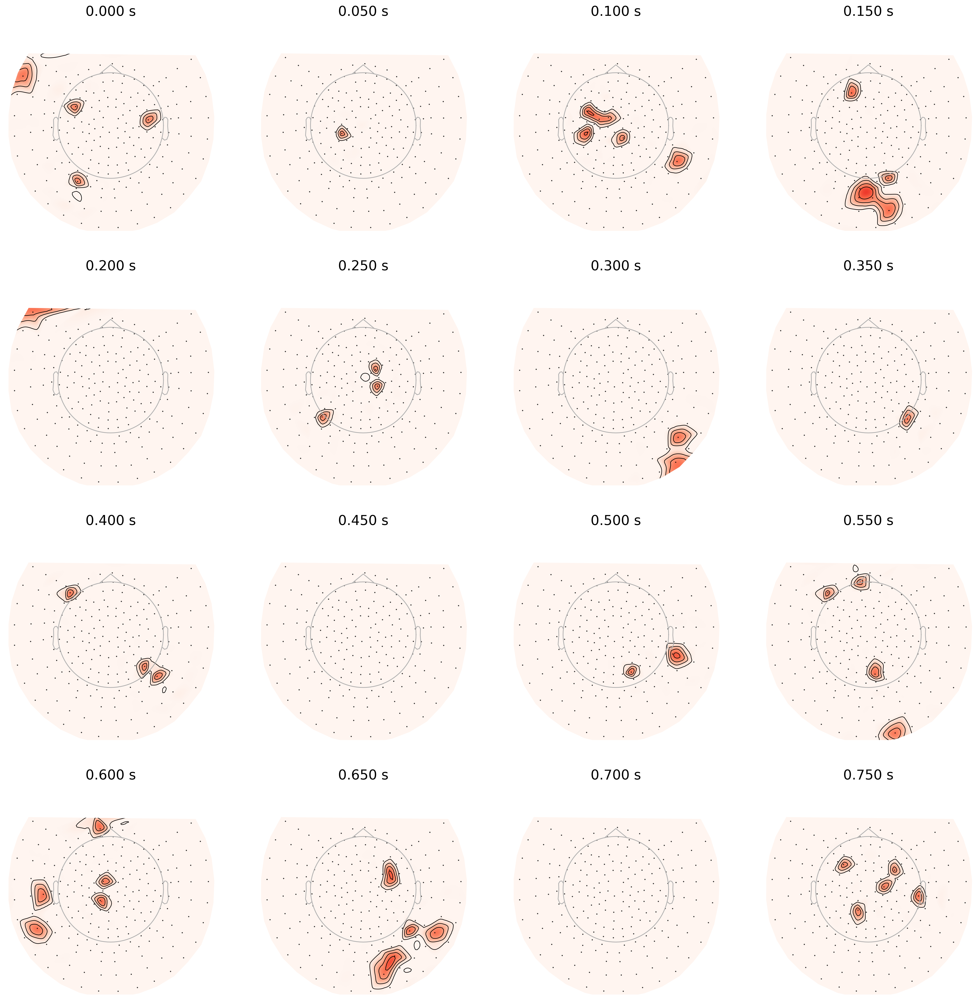

<Figure size 1920x1440 with 0 Axes>

In [133]:
corr = corr_sig["glove2"].copy()
corr[~h0_rejected["glove2"]] = 1.0
evo = mne.EvokedArray(corr.reshape(208, 81), info)
times = np.arange(0.0, 0.8, 0.05)
evo.plot_topomap(times, cmap="Reds_r", ncols=4, nrows=4, colorbar=False, res=128, size=3)
plt.savefig("../figures/sig-corrected-glove-2.pdf")
plt.show()

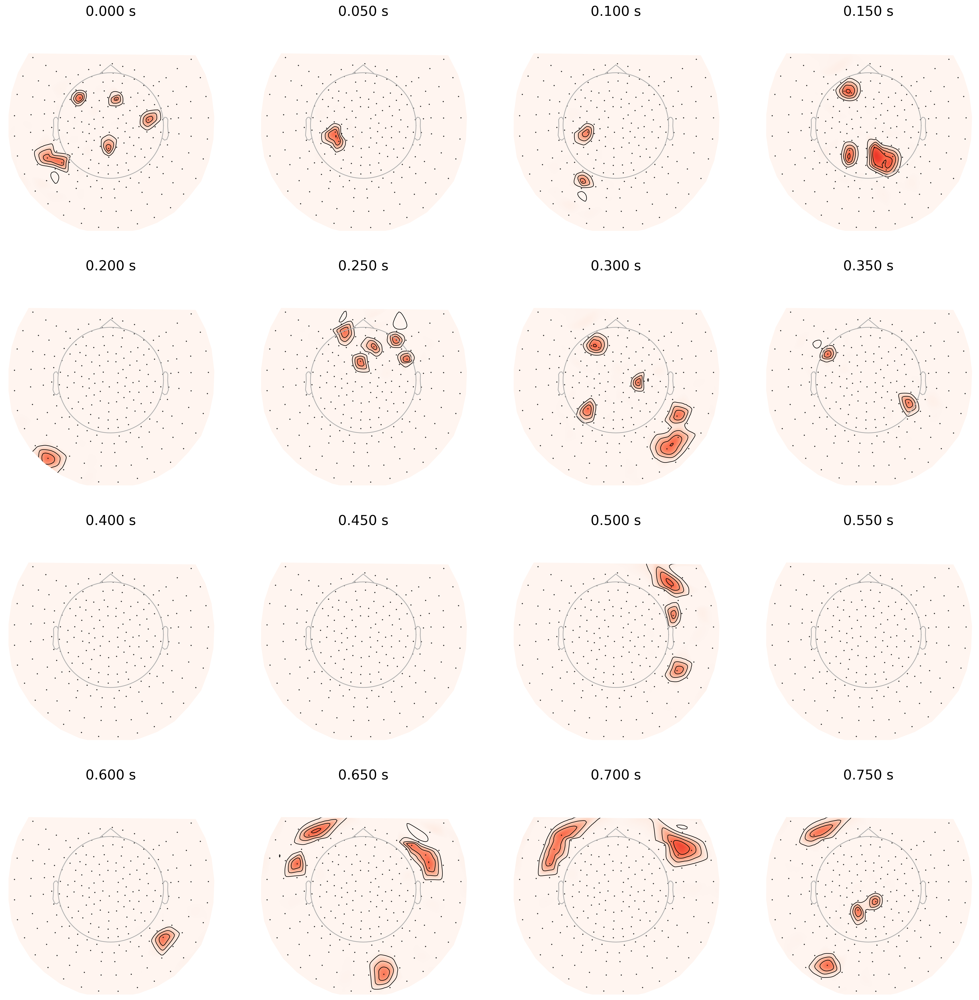

<Figure size 1920x1440 with 0 Axes>

In [139]:
corr = corr_sig["postag2"].copy()
corr[~h0_rejected["postag2"]] = 1.0
evo = mne.EvokedArray(corr.reshape(208, 81), info)
times = np.arange(0.0, 0.8, 0.05)
evo.plot_topomap(times, cmap="Reds_r", ncols=4, nrows=4, colorbar=False, res=128, size=3)
plt.savefig("../figures/sig-corrected-postag-2.pdf")
plt.show()